
# Analysis of a video game sales dataset

# Content

* Introduction
* Stage 1. Data Review.
    * First Impressions and Conclusions
* Stage 2. Data Preprocessing
    * 2.1 Header Style
    * 2.2 Duplicate and Missing Values
    * 2.4 Observations
* Stage 3. Data Analysis
* Stage 4. Create a User Profile for Each Region
* Stage 5. Hypothesis Testing
    * 5.1 Hypothesis 1: User Activity in the Two Cities
    * 5.2 Hypothesis 2: User Activity in the Two Cities
* Conclusions

# Introduction <a id='intro'></a>

This project analyzes a video game sales dataset, identifying patterns and trends that allow us to identify whether a game is successful. This determines a game's potential, the need for advertising, the most popular genres, etc.

The dataset spans video games released from the 1980s to 2016 and their evolution in the market. The techniques studied above will be applied to answer several questions.

In [252]:
# All libraries are loaded

import pandas as pd
import numpy as np
import math
from matplotlib import pyplot as plt
from scipy import stats as st

## Stage 1. Data Review.

In [254]:
# The data file is loaded into a data frame

df_games = pd.read_csv('games.csv')

### First impressions and conclusions

In [256]:
# The data frame information and a sample of the data are printed.

df_games.info()
df_games

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16715 entries, 0 to 16714
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             16713 non-null  object 
 1   Platform         16715 non-null  object 
 2   Year_of_Release  16446 non-null  float64
 3   Genre            16713 non-null  object 
 4   NA_sales         16715 non-null  float64
 5   EU_sales         16715 non-null  float64
 6   JP_sales         16715 non-null  float64
 7   Other_sales      16715 non-null  float64
 8   Critic_Score     8137 non-null   float64
 9   User_Score       10014 non-null  object 
 10  Rating           9949 non-null   object 
dtypes: float64(6), object(5)
memory usage: 1.4+ MB


,Name,Platform,Year_of_Release,Genre,NA_sales,EU_sales,JP_sales,Other_sales,Critic_Score,User_Score,Rating
0,Wii Sports,Wii,2006.0,Sports,41.36,28.96,3.77,8.45,76.0,8,E
1,Super Mario Bros.,NES,1985.0,Platform,29.08,3.58,6.81,0.77,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008.0,Racing,15.68,12.76,3.79,3.29,82.0,8.3,E
3,Wii Sports Resort,Wii,2009.0,Sports,15.61,10.93,3.28,2.95,80.0,8,E
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,11.27,8.89,10.22,1.00,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
16710,Samurai Warriors: Sanada Maru,PS3,2016.0,Action,0.00,0.00,0.01,0.00,NaN,NaN,NaN
16711,LMA Manager 2007,X360,2006.0,Sports,0.00,0.01,0.00,0.00,NaN,NaN,NaN
16712,Haitaka no Psychedelica,PSV,2016.0,Adventure,0.00,0.00,0.01,0.00,NaN,NaN,NaN
16713,Spirits & Spells,GBA,2003.0,Platform,0.01,0.00,0.00,0.00,NaN,NaN,NaN


**Observation:**
1. Dataframe with 16,715 measurements about video games.
2. The column names are not in a format that is easy to analyze, so uppercase letters will be changed to lowercase.
3. There are null values from the third column to the last.
4. For the 'Name' column, the two null values must be due to missing information or data entry errors.
5. For the 'Year_of_Release' column, the null values may be due to the fact that the years in which these games were released are simply unknown; there may be no information about them, or it was due to a data entry error.
6. In the 'Genre' column, there may be similar reasons for missing information, or perhaps the games are multi-genre.
7. Regarding the 'NA_sales', 'EU_sales', 'JP_sales' and 'Other_sales' columns, the null values could be due to the game not being sold in that country, lack of information or there were no sales of that game (which could be the most accurate since they have the same amount of null values) which could be because it was not released to the market.
8. For the 'Critic_Score' column, there likely wasn't a review for that game, which may mean it didn't gain popularity and wasn't taken into account by critics.
9. For the 'User_Score' column, there could be some reasons for point 7, although there are fewer null values here. This may be because individual users were interested in sharing their opinions.
10. In the 'Rating' column, if the value depends on the previous two columns, this may be causing the null values, or it may be that I don't have an established rating.
11. You need to understand these null values to know if they can be replaced with a value or should be removed.
12. You need to calculate if there are duplicate values and decide whether to remove them or simply modify them.
13. The data types of the 'Year_of_Release' and 'User_Score' columns should be changed to int and float, respectively.

## Stage 2. Data Preprocessing

### Header Style

In [260]:
# Column names are changed

df_games.columns = df_games.columns.str.lower()
df_games.columns

Index(['name', 'platform', 'year_of_release', 'genre', 'na_sales', 'eu_sales',
       'jp_sales', 'other_sales', 'critic_score', 'user_score', 'rating'],
      dtype='object')

### Duplicate and Missing Values

In [262]:
# Check for duplicate data

print(df_games[df_games.duplicated()])

Empty DataFrame
Columns: [name, platform, year_of_release, genre, na_sales, eu_sales, jp_sales, other_sales, critic_score, user_score, rating]
Index: []


### Observations

**Observations**

1. Null values in the 'name' column will be changed to 'no_name' and their type will remain the same.
2. Null values in the 'year_of_release' column will be changed to '0' and converted to 'int' type. 0 means: unknown year.
3. Null values in the 'genre' column will be changed to 'no_genre' and will remain the same type.
4. Null values in the 'critic_score' column will be changed to '0' and converted to 'int' type since there are no decimal places. 0 means no punctuation.
5. Null values in the 'user_score' column will be changed to 'no_score' for the time being, as there are 'tbd' string values. It is not yet known if this will be important in subsequent analysis. If not, it can be changed to '0' and the column can be changed to a floating point type.
6. Null values in the 'rating' column will be changed to 'no_rating', and its type will remain the same.

In [265]:
# Since there is no duplicate data, the null data is changed.
df_games.fillna({'name': 'no_name'}, inplace=True)
df_games.fillna({'year_of_release': '0'}, inplace=True)
df_games.fillna({'genre': 'no_genre'}, inplace=True)
df_games.fillna({'critic_score': '0'}, inplace=True)
df_games.fillna({'user_score': '0'}, inplace=True)
df_games.fillna({'rating': 'no_rating'}, inplace=True)
df_games['user_score'] = df_games['user_score'].replace('tbd',0)

# Now we change the data type in the columns that are considered necessary
df_games['year_of_release'] = df_games['year_of_release'].astype('int')
df_games['critic_score'] = df_games['critic_score'].astype('int')
df_games['user_score'] = df_games['user_score'].astype('float')

# Show data
df_games.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16715 entries, 0 to 16714
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   name             16715 non-null  object 
 1   platform         16715 non-null  object 
 2   year_of_release  16715 non-null  int32  
 3   genre            16715 non-null  object 
 4   na_sales         16715 non-null  float64
 5   eu_sales         16715 non-null  float64
 6   jp_sales         16715 non-null  float64
 7   other_sales      16715 non-null  float64
 8   critic_score     16715 non-null  int32  
 9   user_score       16715 non-null  float64
 10  rating           16715 non-null  object 
dtypes: float64(5), int32(2), object(4)
memory usage: 1.3+ MB


In [272]:
# Total sales are calculated
df_games['total_sales'] = df_games[['na_sales', 'eu_sales', 'jp_sales', 'other_sales']].sum(axis=1)

# show the new df
df_games.head()

,name,platform,year_of_release,genre,na_sales,eu_sales,jp_sales,other_sales,critic_score,user_score,rating,total_sales
0,Wii Sports,Wii,2006,Sports,41.36,28.96,3.77,8.45,76,8.0,E,82.54
1,Super Mario Bros.,NES,1985,Platform,29.08,3.58,6.81,0.77,0,0.0,no_rating,40.24
2,Mario Kart Wii,Wii,2008,Racing,15.68,12.76,3.79,3.29,82,8.3,E,35.52
3,Wii Sports Resort,Wii,2009,Sports,15.61,10.93,3.28,2.95,80,8.0,E,32.77
4,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,11.27,8.89,10.22,1.00,0,0.0,no_rating,31.38


## Stage 3. Data Analysis

year_of_release
0        269
1980       9
1981      46
1982      36
1983      17
1984      14
1985      14
1986      21
1987      16
1988      15
1989      17
1990      16
1991      41
1992      43
1993      62
1994     121
1995     219
1996     263
1997     289
1998     379
1999     338
2000     350
2001     482
2002     829
2003     775
2004     762
2005     939
2006    1006
2007    1197
2008    1427
2009    1426
2010    1255
2011    1136
2012     653
2013     544
2014     581
2015     606
2016     502
Name: count, dtype: int64


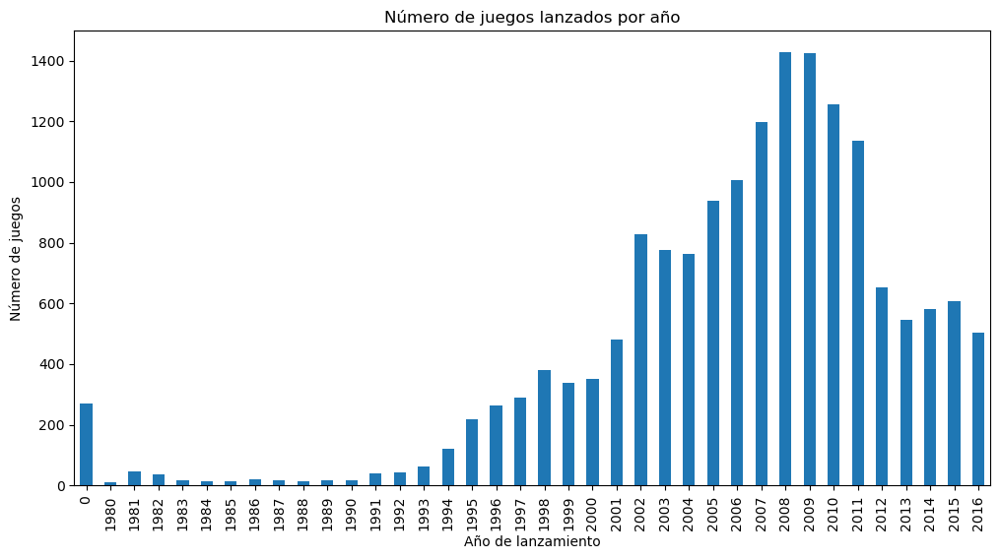

In [274]:
# The number of games per year is calculated
games_per_year = df_games['year_of_release'].value_counts().sort_index()
# Or it can also be calculated as: games_per_year = df_games.pivot_table(index=['year_of_release'], values=['name'], aggfunc=['count']).reset_index()
print(games_per_year)

# Show the number of games released per year
games_per_year.plot(kind='bar', figsize=(12, 6), title='Número de juegos lanzados por año')
plt.xlabel('Año de lanzamiento')
plt.ylabel('Número de juegos')
plt.show()

Yes, the data by year are significant since they present a normal distribution shifted to the right, this tells us that there is a trend in the sale of games, with this we can make several assumptions that will be clarified with the following analysis, for example we could think that the best games were released in the first decade of the 2000s, or that there was a favorable change in consoles or video games, that video games had the best marketing in these years, etc...

In [276]:
# Sales are calculated by platform
platform_sales = df_games.pivot_table(index=['platform'], values=['total_sales'], aggfunc=['sum'])
platform_sales.sort_values(by=[('sum', 'total_sales')], ascending=False, inplace=True)

# Show values
platform_sales

,sum
,total_sales
platform,
PS2,1255.77
X360,971.42
PS3,939.65
Wii,907.51
DS,806.12
PS,730.86
GBA,317.85
PS4,314.14


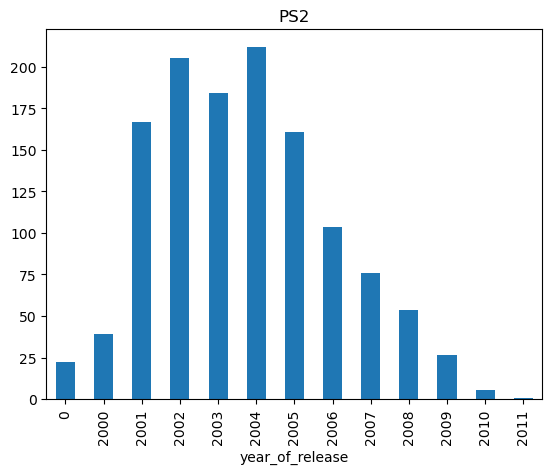

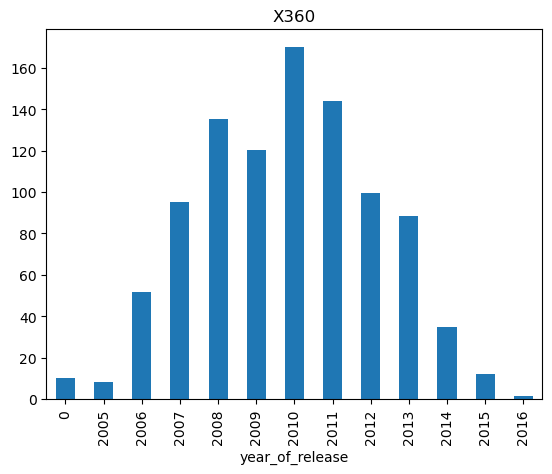

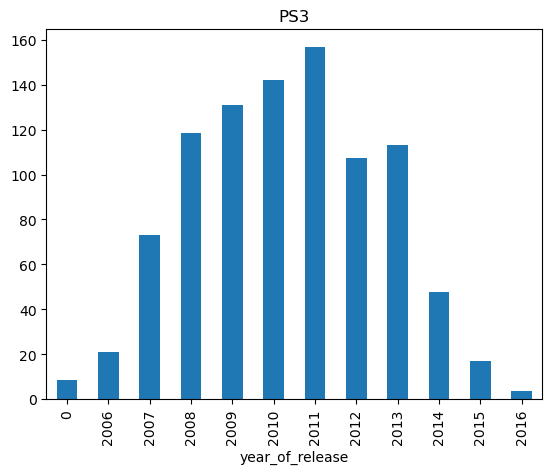

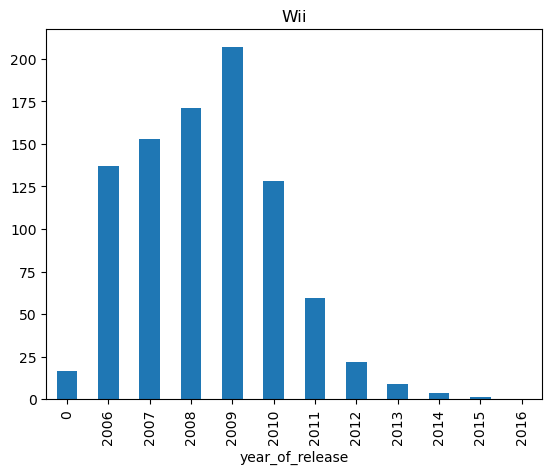

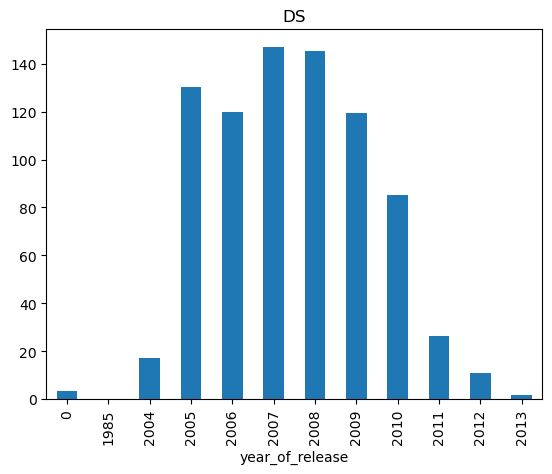

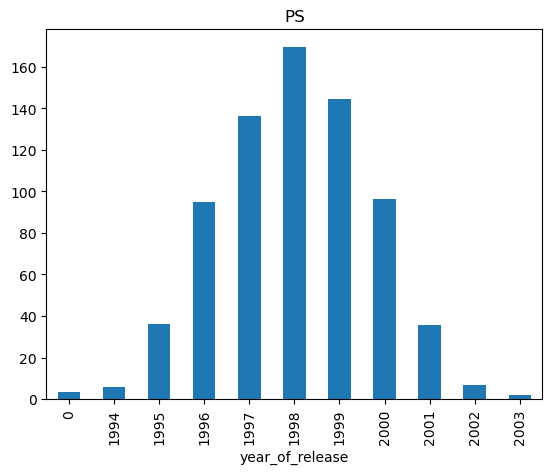

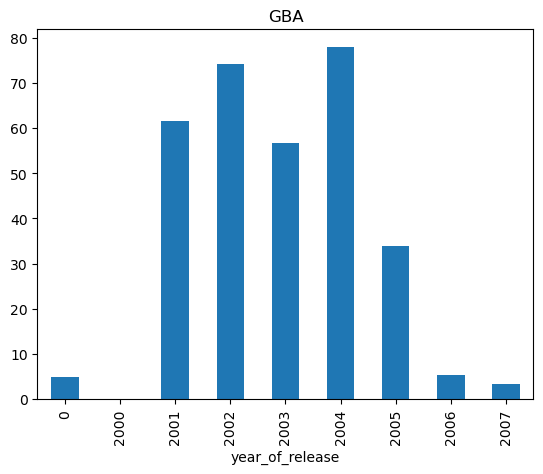

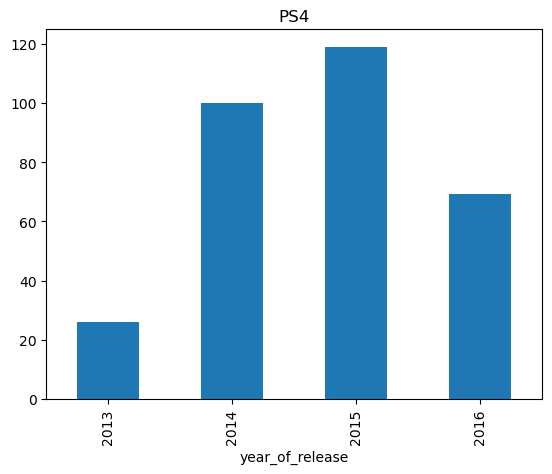

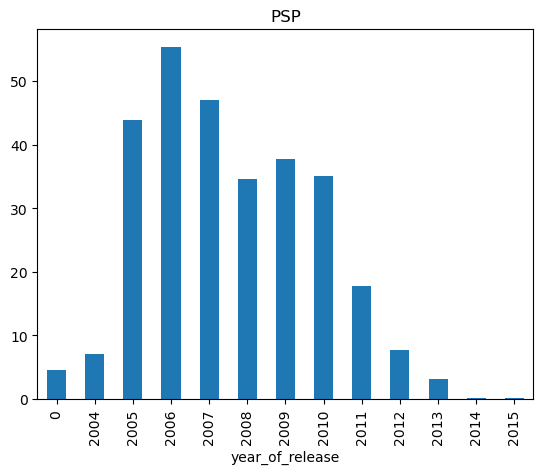

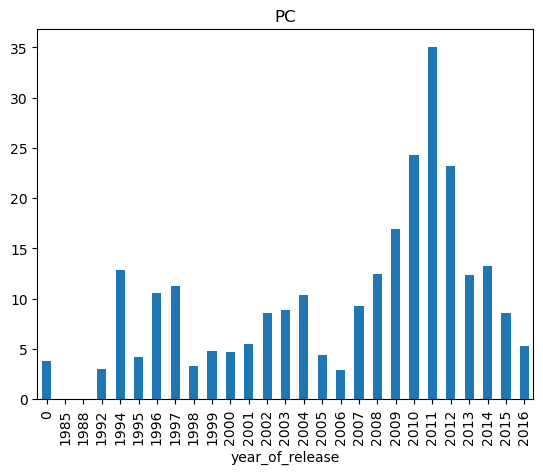

In [277]:
# The 5 main platforms are PS2, X360, PS3, Wii and DS, with these we graph the distribution of sales by year
top_platforms = platform_sales.head(10).index

# Sales distribution by year for the main platforms
for platform in top_platforms:
    platform_data = df_games[df_games['platform'] == platform].groupby('year_of_release')['total_sales'].sum()
    platform_data.plot(kind='bar', title=platform)
    plt.show()


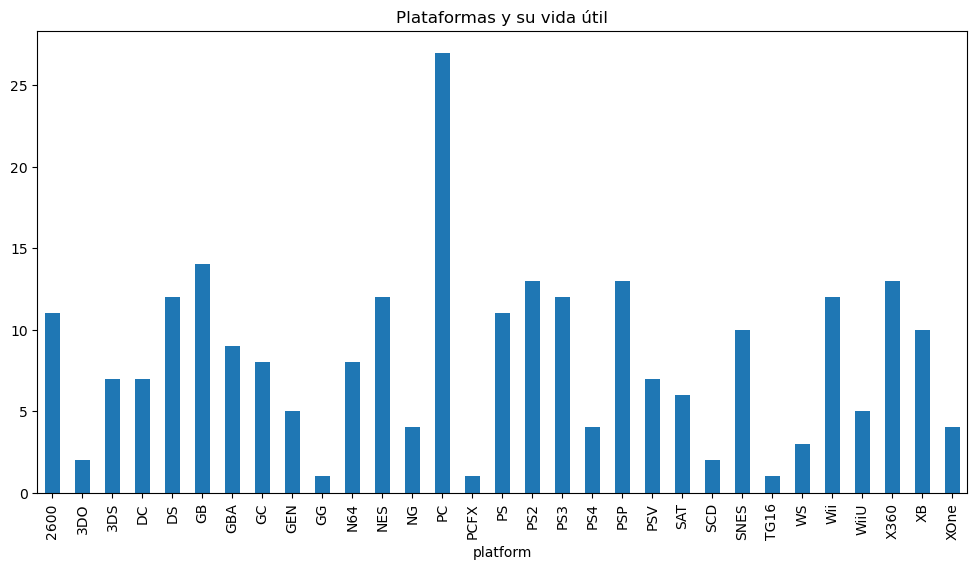

8.193548387096774


In [278]:
# Identify popular platforms that no longer have sales
platforms_by_year = df_games.groupby(['platform', 'year_of_release']).size().unstack(fill_value=0)

# Results are displayed
plt.figure(figsize=(12, 6))
platforms_lifetime = (platforms_by_year != 0).sum(axis=1)
platforms_lifetime.plot(kind='bar', title='Plataformas y su vida útil')
plt.show()

print(platforms_lifetime.mean())

Based on the answers above, the five most popular platforms lasted between 11 and 12 years in sales. If we look at the distribution of PlayStation sales by year, we see that PS2 begins sales 7 years after PS, PS3 begins sales 8 years after PS2, and PS4 begins sales 7 years after PS3. For XBOX, it takes between 9 and 6 years for new platforms to begin sales, and for Nintendo, it takes between 7 and 8 years. Therefore, on average, new platforms take about 7.5 years to begin sales after the previous platform begins, and a platform disappears between 11 and 12 years for the most popular platforms.

Taking all platforms into account, the average lifespan is approximately 8.19 years in sales.

Since we observed that the platforms with the most sales start from the year 2000, we established this year to take data

In [281]:
# Define the relevant period
relevant_years = df_games[df_games['year_of_release'] >= 2000]
print(relevant_years.head())

                    name platform  year_of_release     genre  na_sales  \
0             Wii Sports      Wii             2006    Sports     41.36   
2         Mario Kart Wii      Wii             2008    Racing     15.68   
3      Wii Sports Resort      Wii             2009    Sports     15.61   
6  New Super Mario Bros.       DS             2006  Platform     11.28   
7               Wii Play      Wii             2006      Misc     13.96   

   eu_sales  jp_sales  other_sales  critic_score  user_score rating  \
0     28.96      3.77         8.45            76         8.0      E   
2     12.76      3.79         3.29            82         8.3      E   
3     10.93      3.28         2.95            80         8.0      E   
6      9.14      6.50         2.88            89         8.5      E   
7      9.18      2.93         2.84            58         6.6      E   

   total_sales  
0        82.54  
2        35.52  
3        32.77  
6        29.80  
7        28.91  


platform
PS2     1233.56
X360     961.24
PS3      931.34
Wii      891.18
DS       802.76
PS4      314.14
GBA      312.88
PSP      289.53
3DS      257.81
XB       251.57
PC       205.72
GC       196.73
XOne     159.32
PS       140.70
WiiU      82.19
PSV       53.81
N64       37.30
GB        29.00
DC         7.41
WS         0.96
Name: total_sales, dtype: float64


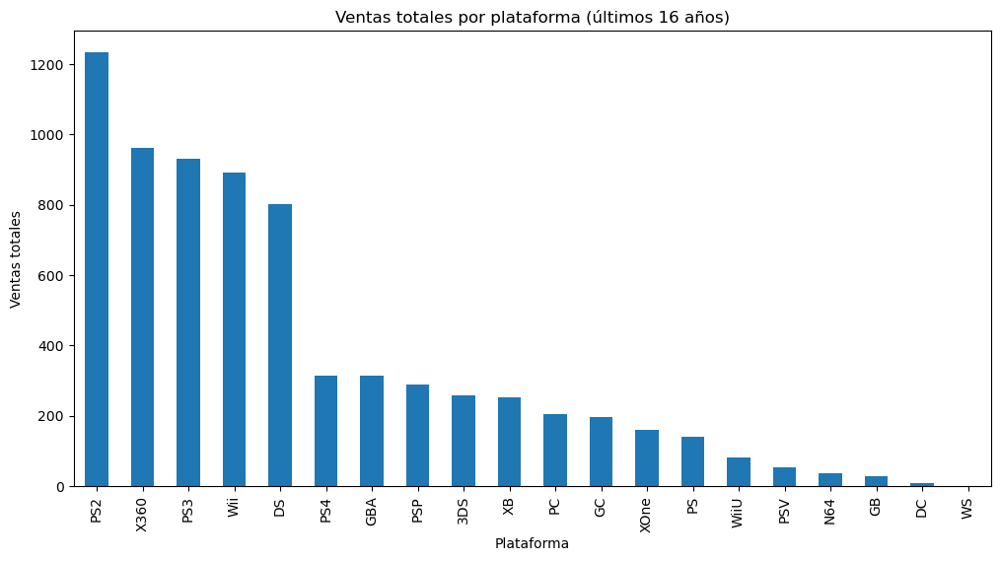

In [282]:
# Group by platform and add up the total sales
platform_sales_recent = relevant_years.groupby('platform')['total_sales'].sum().sort_values(ascending=False)
print(platform_sales_recent)

# Select the platforms with the highest total sales in the relevant period
top_recent_platforms = platform_sales_recent.head(5).index

# View sales by platform
platform_sales_recent.plot(kind='bar', figsize=(12, 6), title='Ventas totales por plataforma (últimos 16 años)')
plt.xlabel('Plataforma')
plt.ylabel('Ventas totales')
plt.show()

It's clear that the leading platforms are PlayStation (PS), Xbox (XB), and Nintendo. PS and XB are growing while the other platforms are shrinking. If we were to choose profitable platforms, they would be:
* PS4
* XOne
* PC
* WiiU

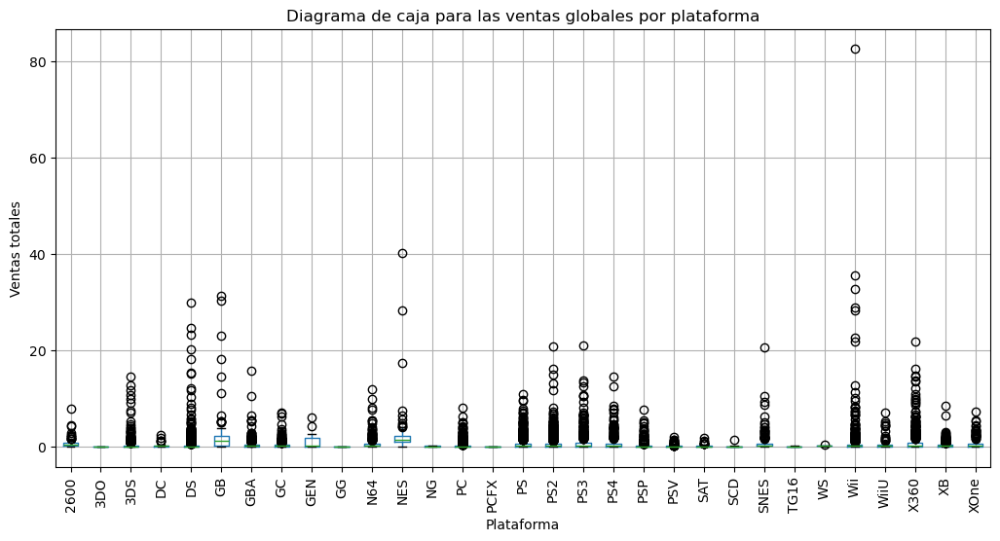

In [286]:
# Create a box plot for global sales by platform
df_games.boxplot(column='total_sales', by='platform', figsize=(12, 6), rot=90)
plt.title('Diagrama de caja para las ventas globales por plataforma')
plt.suptitle('')
plt.xlabel('Plataforma')
plt.ylabel('Ventas totales')
#plt.ylim(0,10)
plt.show()

There doesn't seem to be much of a difference between the sales averages by platform, with the exception of GB and NES. Noting that most have a sales average between 0 and 1, it can be deduced that most platforms follow a trend in their duration and years of sale. Another important thing to note is that there are many outliers, which shows how there are periods of years in which platforms have their sales peak and then decline until they disappear. The Wii platform has the largest outlier.

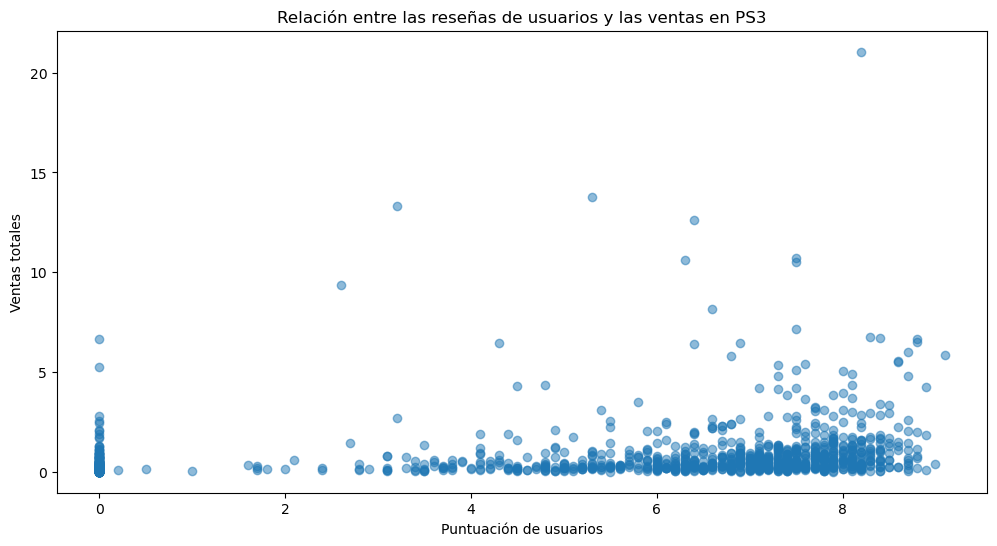

Correlación entre las reseñas de usuarios y las ventas: 0.2740254598122624


In [288]:
# Select a popular platform
popular_platform = top_recent_platforms[2]
platform_data = df_games[df_games['platform'] == popular_platform]

# Create a scatter chart for user reviews and sales
plt.figure(figsize=(12, 6))
plt.scatter(platform_data['user_score'], platform_data['total_sales'], alpha=0.5)
plt.title(f'Relación entre las reseñas de usuarios y las ventas en {popular_platform}')
plt.xlabel('Puntuación de usuarios')
plt.ylabel('Ventas totales')
plt.show()

# Calculate the correlation
correlation_user1 = platform_data['user_score'].corr(platform_data['total_sales'])
print(f'Correlación entre las reseñas de usuarios y las ventas: {correlation_user1}')

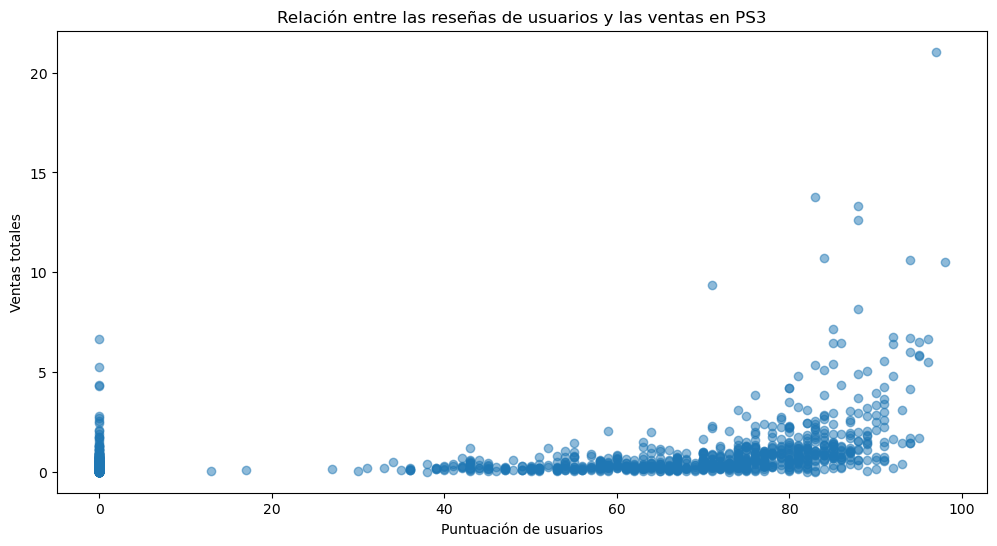

Correlation between reviews of critics and sales: 0.35506567598487354


In [289]:
# Create a scatter chart for user reviews and sales
plt.figure(figsize=(12, 6))
plt.scatter(platform_data['critic_score'], platform_data['total_sales'], alpha=0.5)
plt.title(f'Relación entre las reseñas de usuarios y las ventas en {popular_platform}')
plt.xlabel('Puntuación de usuarios')
plt.ylabel('Ventas totales')
plt.show()

# Calculate the correlation
correlation_user2 = platform_data['critic_score'].corr(platform_data['total_sales'])
print(f'Correlation between reviews of critics and sales: {correlation_user2}')

There is very little correlation between sales and reviews from users and critics, this little dependence means that regardless of the reviews the game will have its tendency

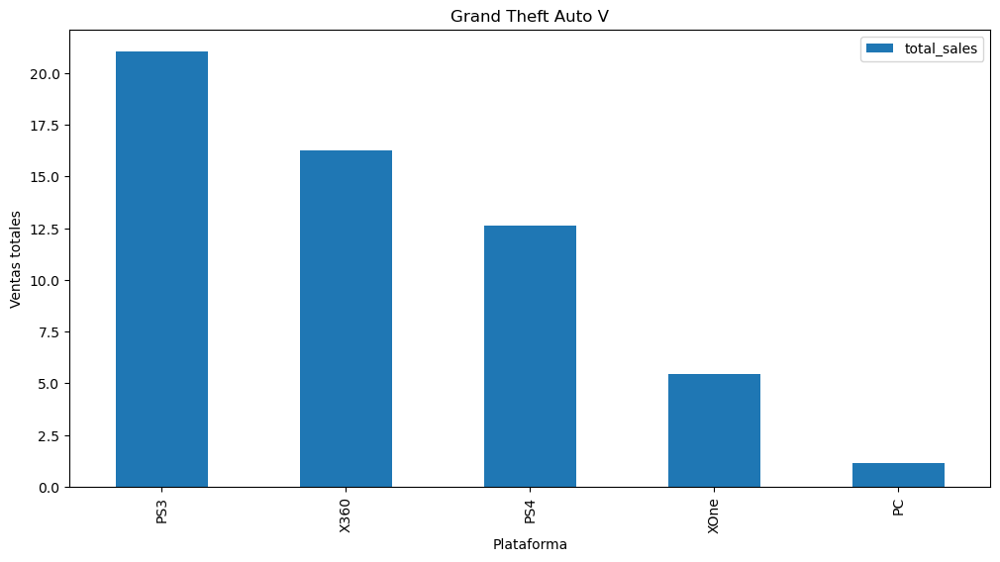

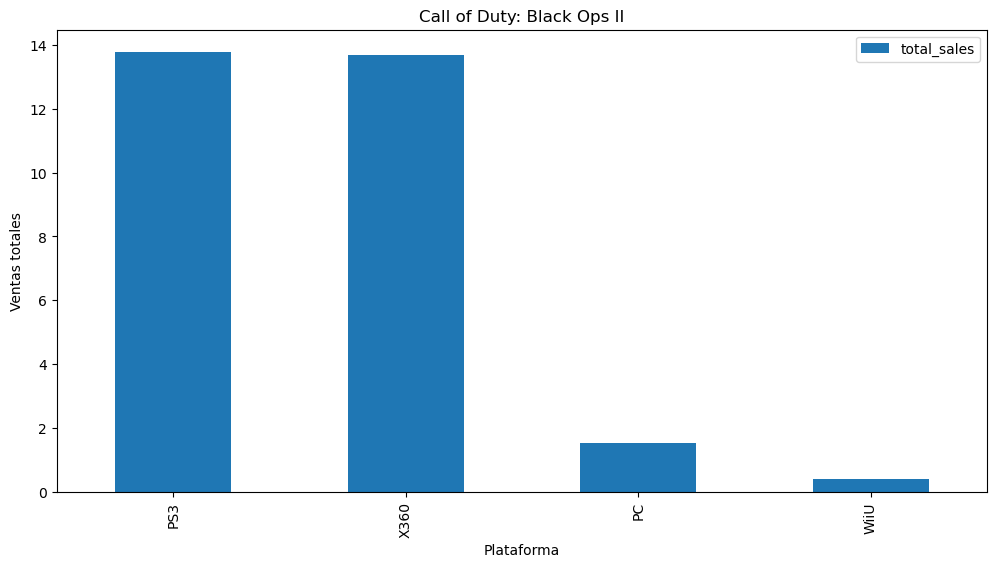

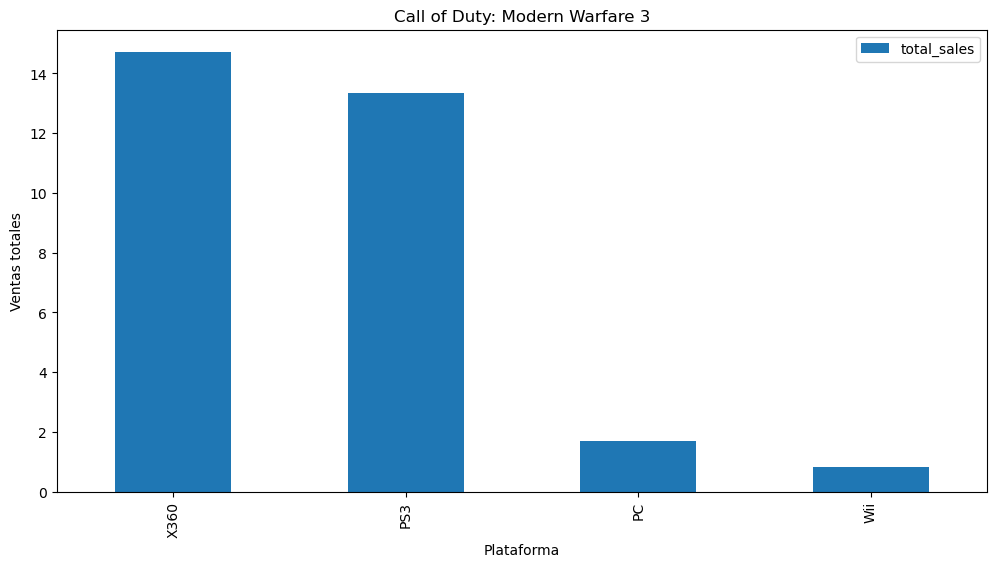

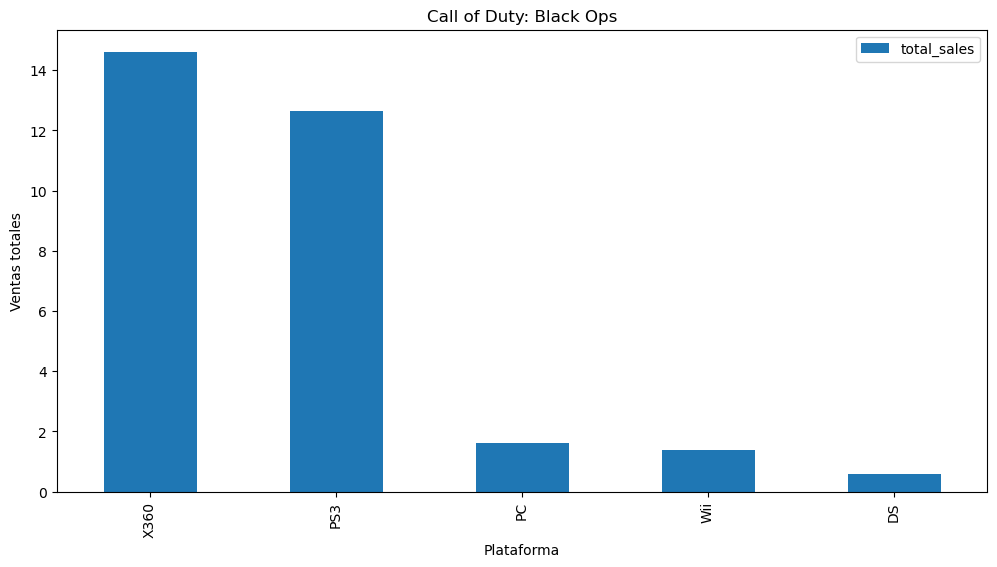

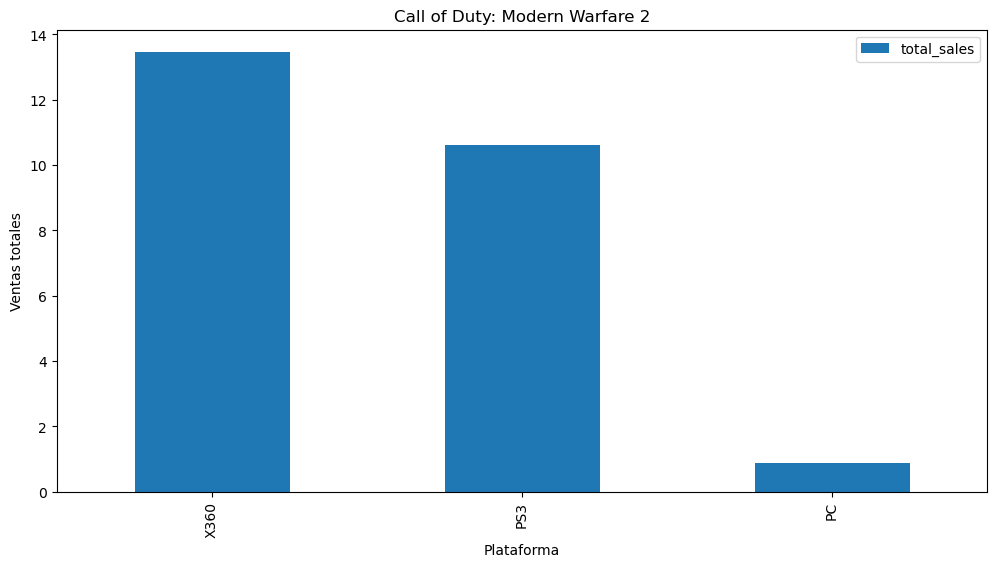

...

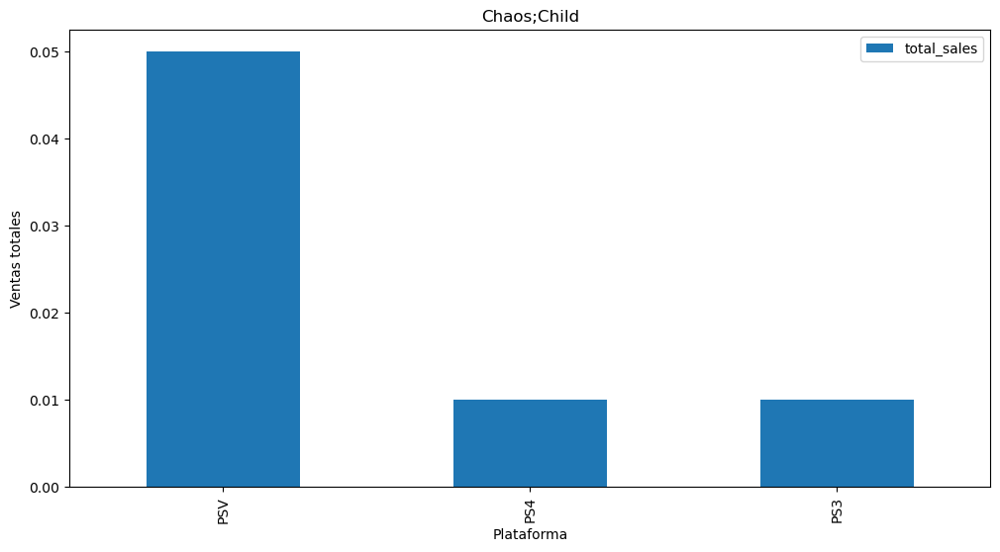

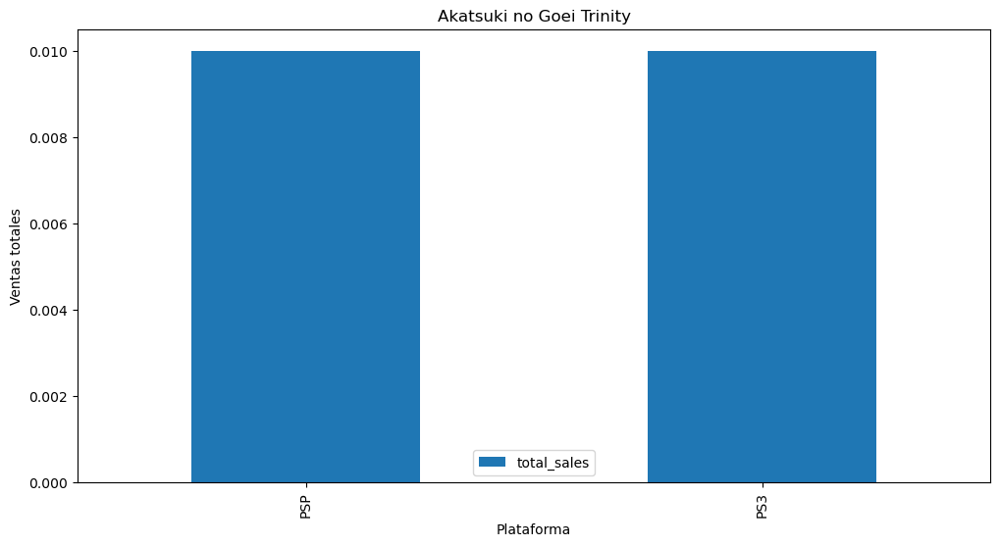

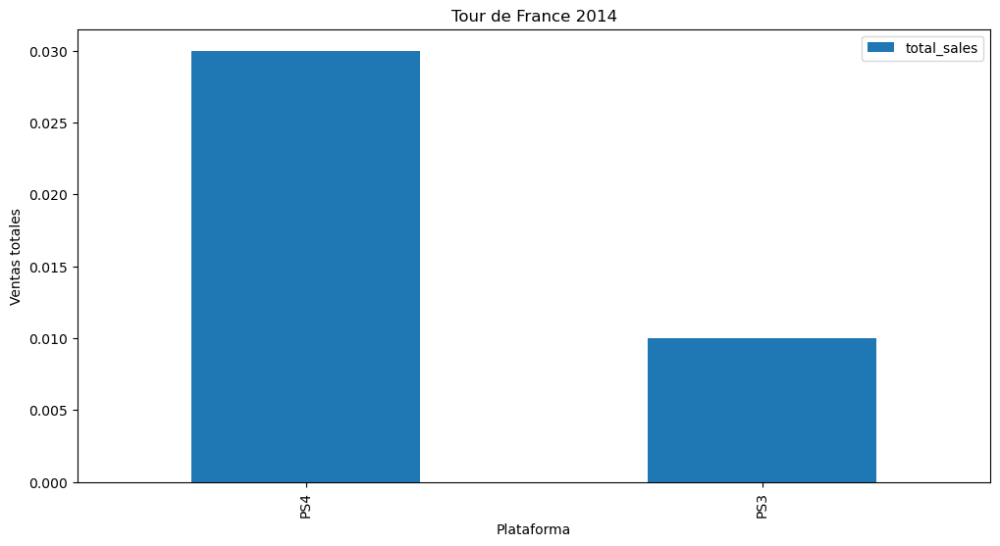

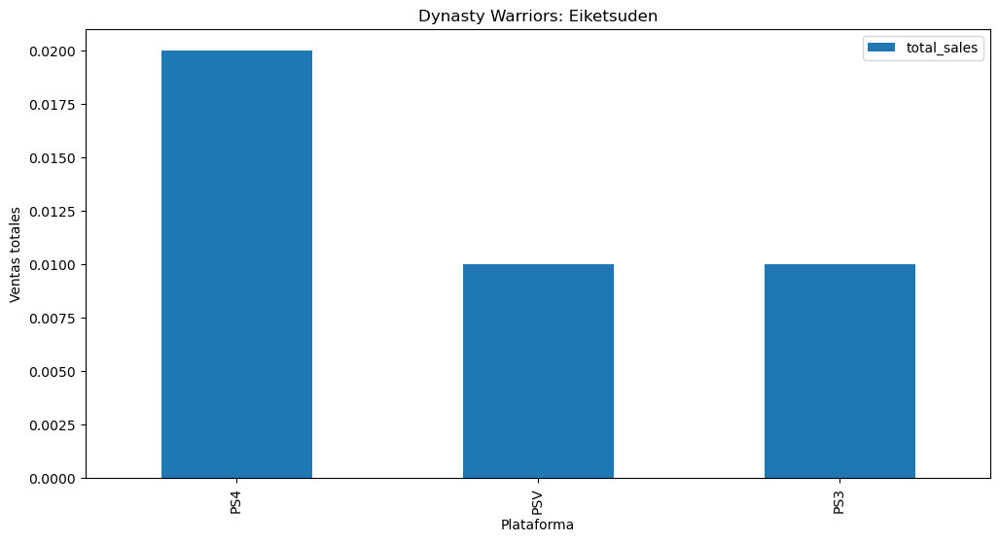

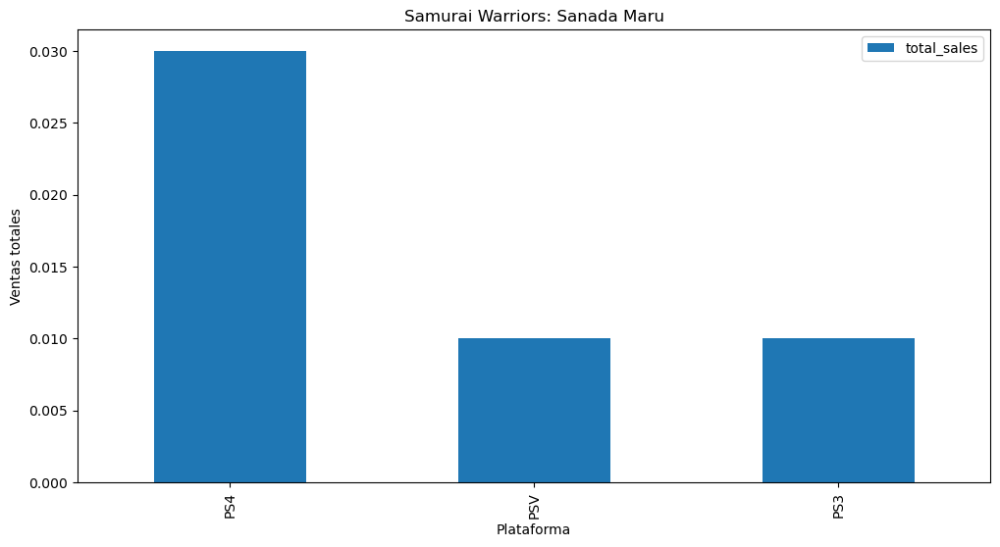

In [291]:
# Compare sales of the same game on different platforms
for game in platform_data['name'].unique():
    game_data = df_games[df_games['name'] == game]
    if len(game_data) > 1:
        game_data.plot(kind='bar', x='platform', y='total_sales', title=game, figsize=(12, 6))
        plt.xlabel('Plataforma')
        plt.ylabel('Ventas totales')
        plt.show()

Games sell more on Play Station and Xbox

genre
Action          1744.17
Sports          1331.27
Shooter         1052.45
Role-Playing     934.56
Platform         827.77
Misc             802.51
Racing           728.67
Fighting         447.53
Simulation       389.97
Puzzle           242.57
Adventure        237.59
Strategy         174.23
no_genre           2.42
Name: total_sales, dtype: float64


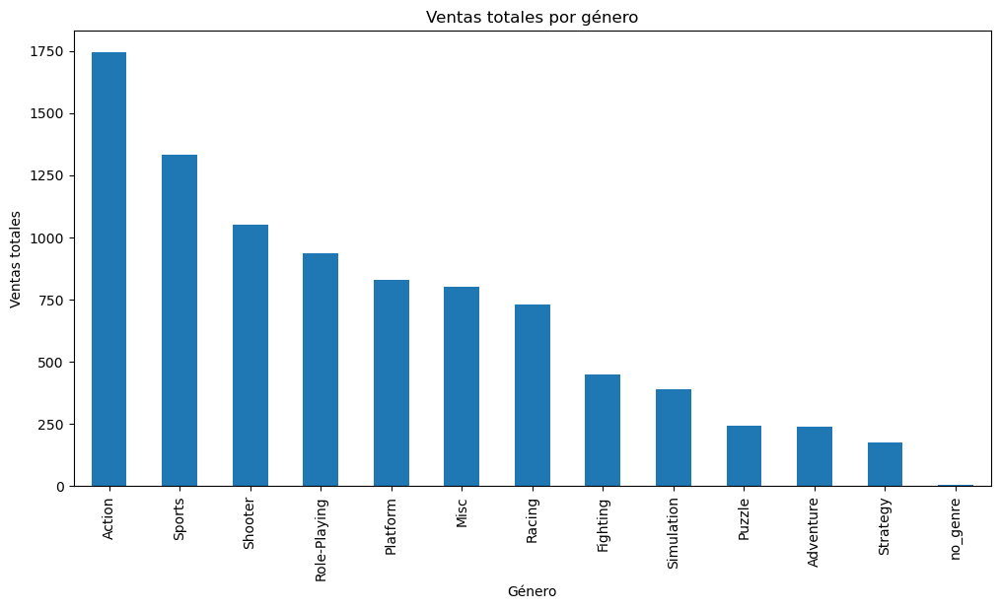

In [293]:
# Group by gender and add up the total sales
genre_sales = df_games.groupby('genre')['total_sales'].sum().sort_values(ascending=False)
print(genre_sales)

# Show sales distribution by gender
genre_sales.plot(kind='bar', figsize=(12, 6), title='Ventas totales por género')
plt.xlabel('Género')
plt.ylabel('Ventas totales')
plt.show()

The top four best-selling genres account for more than half of total sales, so we can say that generalizing the best-selling genres is acceptable. The "Action" genre has about 26% more sales than the next best-selling genre (Sports), although other data must be taken into account.

## Stage 4: Create a user profile for each region

Top 5 plataformas en na_sales
platform
X360    602.47
PS2     583.84
Wii     496.90
PS3     393.49
DS      382.40
Name: na_sales, dtype: float64

Top 5 plataformas en eu_sales
platform
PS2     339.29
PS3     330.29
X360    270.76
Wii     262.21
PS      213.61
Name: eu_sales, dtype: float64

Top 5 plataformas en jp_sales
platform
DS      175.57
PS      139.82
PS2     139.20
SNES    116.55
3DS     100.67
Name: jp_sales, dtype: float64



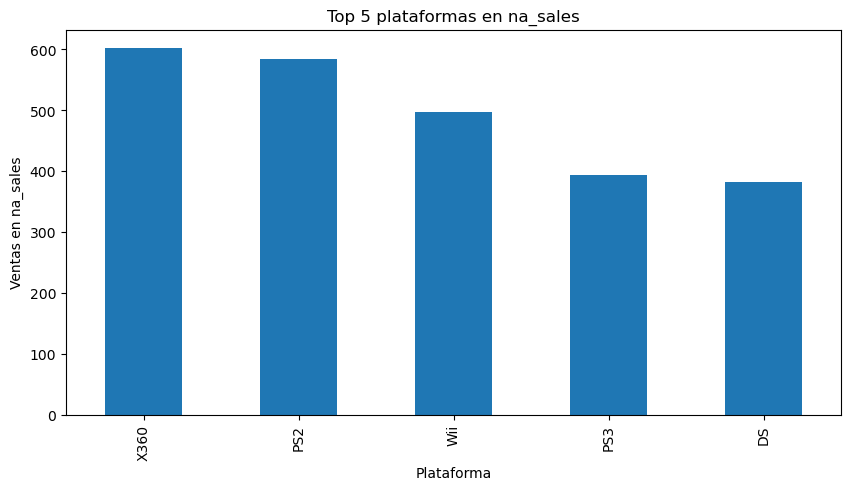

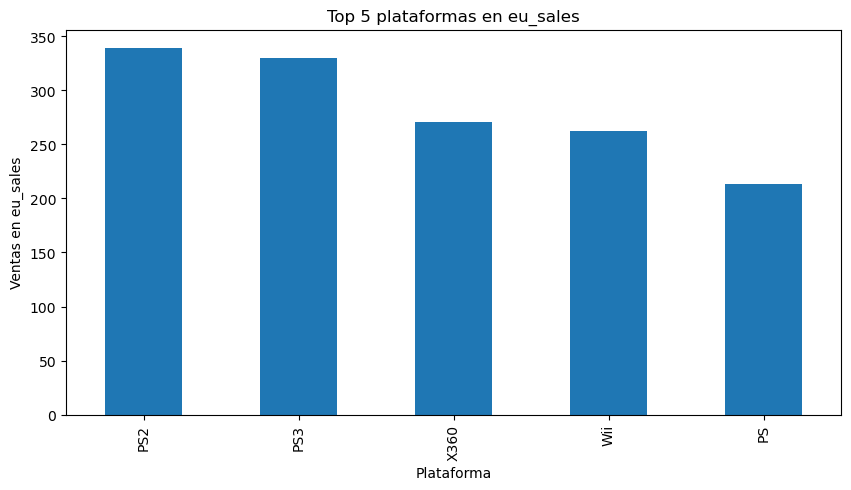

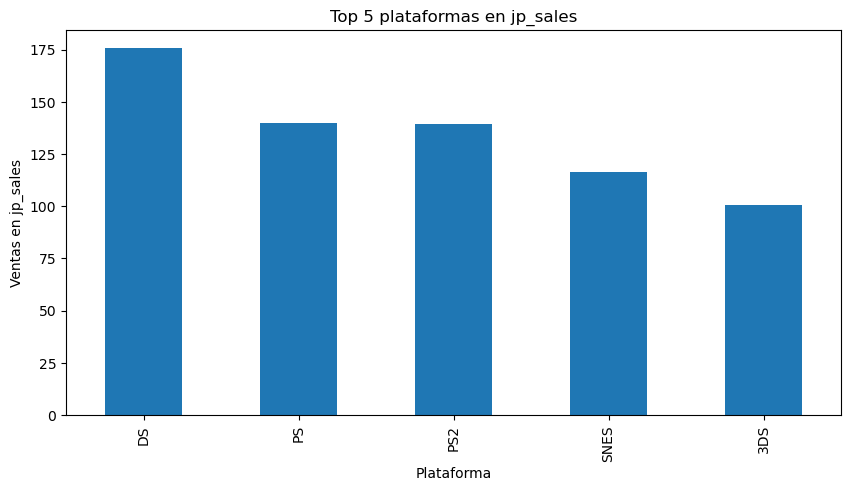

In [297]:
# Determine the top five platforms for each region
regions = ['na_sales', 'eu_sales', 'jp_sales']
top_platforms_by_region = {}

for region in regions:
    top_platforms_by_region[region] = df_games.groupby('platform')[region].sum().sort_values(ascending=False).head(5)
    print(f'Top 5 plataformas en {region}')
    print(top_platforms_by_region[region])
    print()

# Show market shares of the main platforms in each region
for region in regions:
    top_platforms_by_region[region].plot(kind='bar', figsize=(10, 5), title=f'Top 5 plataformas en {region}')
    plt.xlabel('Plataforma')
    plt.ylabel(f'Ventas en {region}')
    plt.show()

It can be seen that the X360 was the platform with the highest sales share in NA, PS2 for EU, and DS for JP. This may indicate a trend in preferred platforms by region. In the USA, Xbox was preferred, in Europe, Play Station, and in Japan, Nintendo.

Top 5 géneros en na_sales
genre
Action      879.01
Sports      684.43
Shooter     592.24
Platform    445.50
Misc        407.27
Name: na_sales, dtype: float64

Top 5 géneros en eu_sales
genre
Action     519.13
Sports     376.79
Shooter    317.34
Racing     236.51
Misc       212.74
Name: eu_sales, dtype: float64

Top 5 géneros en jp_sales
genre
Role-Playing    355.41
Action          161.43
Sports          135.54
Platform        130.83
Misc            108.11
Name: jp_sales, dtype: float64



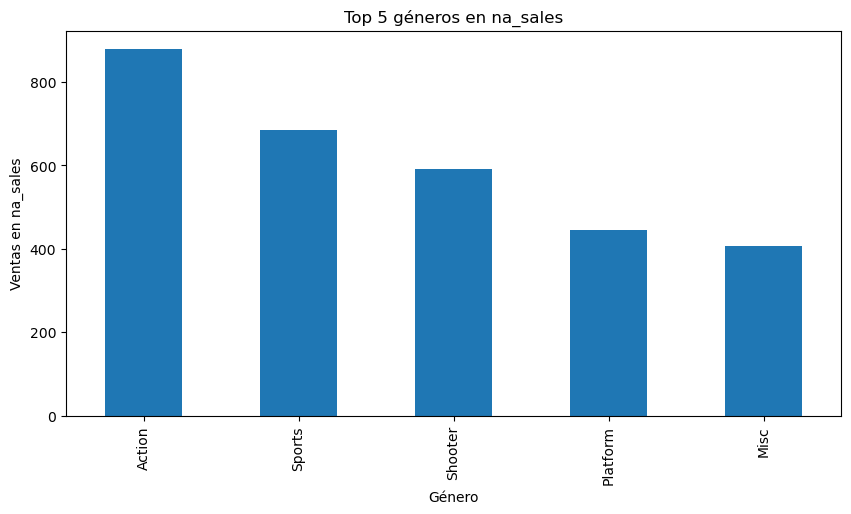

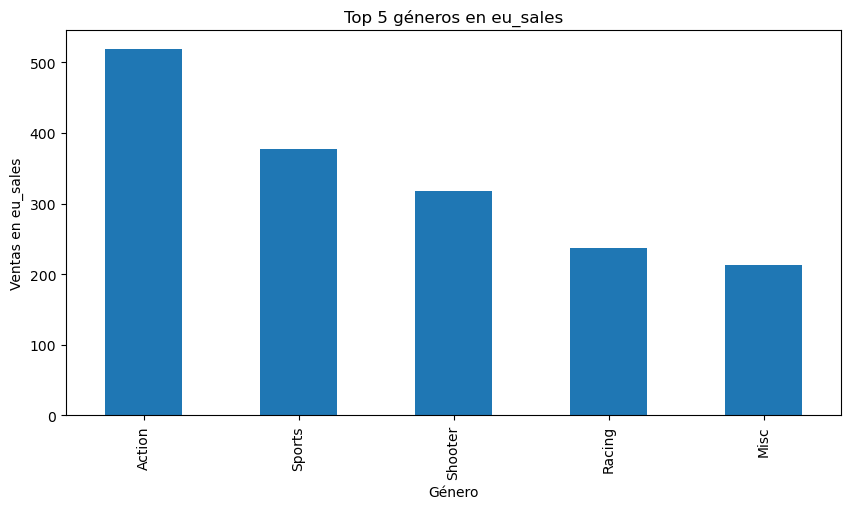

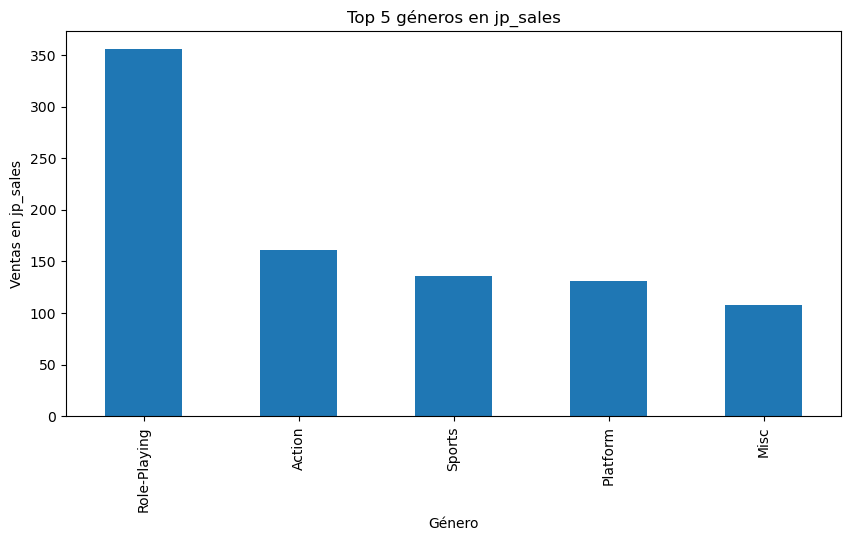

In [299]:
# Determine the top five genres for each region
top_genres_by_region = {}

for region in regions:
    top_genres_by_region[region] = df_games.groupby('genre')[region].sum().sort_values(ascending=False).head(5)
    print(f'Top 5 géneros en {region}')
    print(top_genres_by_region[region])
    print()

# Show market shares of the main genres in each region
for region in regions:
    top_genres_by_region[region].plot(kind='bar', figsize=(10, 5), title=f'Top 5 géneros en {region}')
    plt.xlabel('Género')
    plt.ylabel(f'Ventas en {region}')
    plt.show()

In "na" and "eu" the taste for video game genre is very similar, varying only in the fourth position with "platform" for "na" and "racing" for "eu", in the case of "jp" "shooter" is substituted for "role-playing" in the first place, this shows a different tendency for Japan in genre tastes

Impacto de las clasificaciones de ESRB en na_sales
rating
E            1292.99
no_rating    1242.46
T             759.75
M             748.48
E10+          353.32
K-A             2.56
EC              1.53
AO              1.26
RP              0.00
Name: na_sales, dtype: float64

Impacto de las clasificaciones de ESRB en eu_sales
rating
E            710.25
no_rating    613.83
M            483.97
T            427.03
E10+         188.52
AO             0.61
K-A            0.27
EC             0.11
RP             0.08
Name: eu_sales, dtype: float64

Impacto de las clasificaciones de ESRB en jp_sales
rating
no_rating    841.96
E            198.11
T            151.40
M             64.24
E10+          40.20
K-A            1.46
AO             0.00
EC             0.00
RP             0.00
Name: jp_sales, dtype: float64



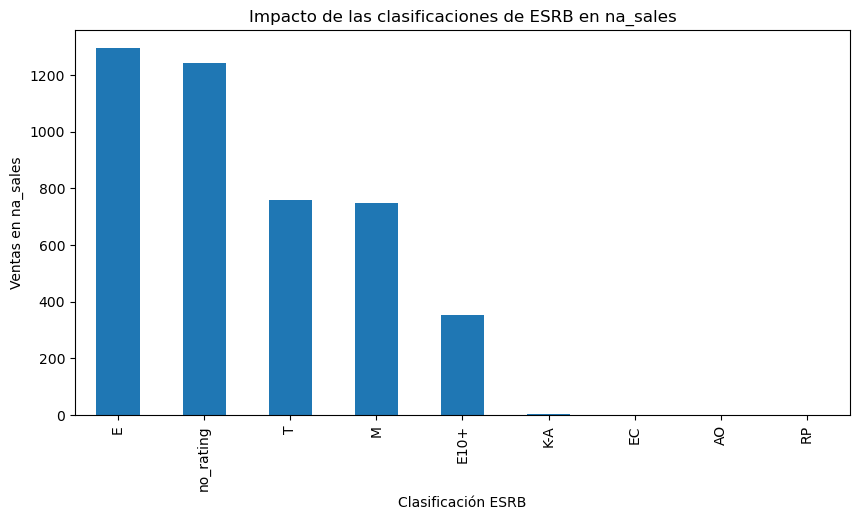

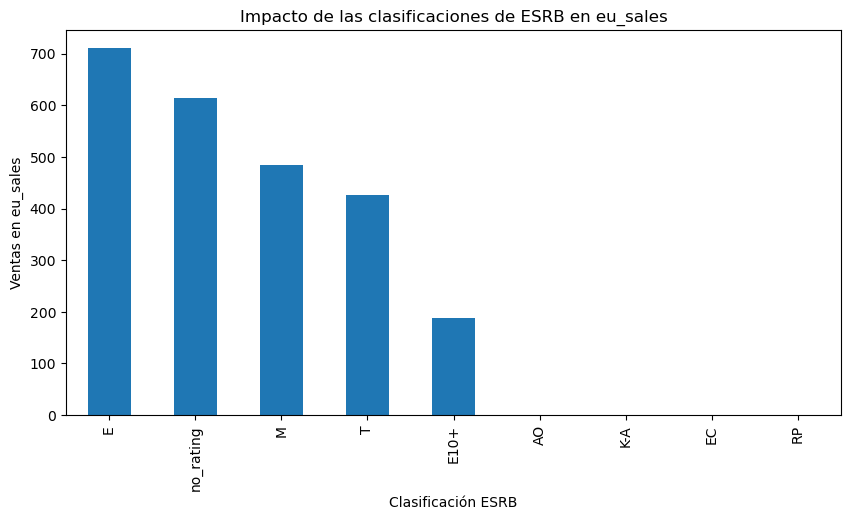

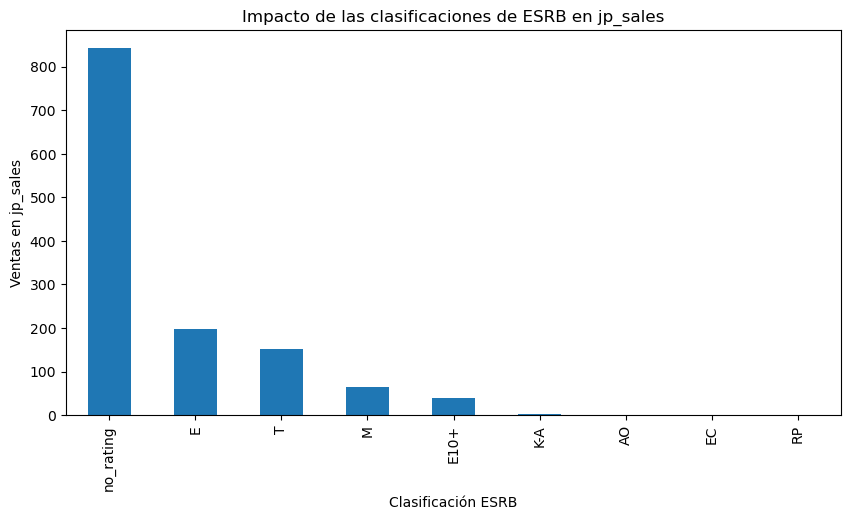

In [301]:
# Analyze the impact of ESRB ratings on sales by region
esrb_sales_by_region = {}

for region in regions:
    esrb_sales_by_region[region] = df_games.groupby('rating')[region].sum().sort_values(ascending=False)
    print(f'Impacto de las clasificaciones de ESRB en {region}')
    print(esrb_sales_by_region[region])
    print()

# Show the impact of ESRB ratings on sales by region
for region in regions:
    esrb_sales_by_region[region].plot(kind='bar', figsize=(10, 5), title=f'Impacto de las clasificaciones de ESRB en {region}')
    plt.xlabel('Clasificación ESRB')
    plt.ylabel(f'Ventas en {region}')
    plt.show()

It is observed that "E", "T", "M" are the ratings that have the most impact, along with unranked games, the latter being much more impactful in Japan, these unranked games could be part of these 3 rankings.

## Hypothesis testing

Recommendations - Hypothesis Testing
Recommendation on Identifying and Removing Outliers

It's a good idea to consider identifying and removing outliers before performing a hypothesis test. Outliers can have a significant impact on the mean and variance of your samples, which can lead you to incorrect conclusions. These extreme values ​​can bias your results, affecting the validity of the test. An effective way to handle outliers is to implement the interquartile range (IQR). This method allows you to detect outliers by identifying data that fall outside the range of 1.5 times the IQR, above the third quartile or below the first quartile. By removing these outliers, you can obtain a more representative and reliable sample for your analysis.

Recommendation on Analysis of Variance Before a Hypothesis Test

It is essential to analyze the sample variance before performing a hypothesis test, as the equality or difference in variances can influence how you interpret the results. It is suggested that you implement Levene's test to assess the homogeneity of variances between your samples. This test will help you determine whether the variances of the different samples are equal, which is essential for deciding whether to set the equal_var parameter to True or False when performing the Student's t-test. A significant result in Levene's test would indicate that the variances are different, and if so, you should set equal_var=False to obtain accurate results in the hypothesis test.

In [305]:
# Function to remove outliers using the interquartile range (IQR)
def remove_outliers(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return series[(series >= lower_bound) & (series <= upper_bound)]

### Hypothesis 1: The average user ratings for the Xbox One and PC platforms are the same.

In [307]:
# Filter data for Xbox One and PC
xbox_one_scores = df_games[df_games['platform'] == 'XOne']['user_score']
pc_scores = df_games[df_games['platform'] == 'PC']['user_score']

# Remove outliers
xbox_one_scores = remove_outliers(xbox_one_scores)
pc_scores = remove_outliers(pc_scores)

# Levene's test for equality of variances
levene_stat, levene_p = st.levene(xbox_one_scores, pc_scores)
equal_var = levene_p > 0.05  # Si p > 0.05, asumimos varianzas iguales

# T-Student test
t_stat, p_value = st.ttest_ind(xbox_one_scores, pc_scores, equal_var=equal_var)

# Results
alpha = 0.05
print(f"Hypothesis 1: Xbox One vs. PC user scores")
print(f"Levene test p-value: {levene_p:.5f} (equal_var={equal_var})")
print(f"t-statistic: {t_stat:.5f}, p-value: {p_value:.5f}")

if p_value < alpha:
    print("We reject the null hypothesis: Average user ratings for the Xbox One and PC platforms are different.")
else:
    print("We cannot reject the null hypothesis: The average user ratings for the Xbox One and PC platforms are the same.")

Hypothesis 1: Xbox One vs. PC user scores
Levene test p-value: 0.87653 (equal_var=True)
t-statistic: -3.44831, p-value: 0.00058
We reject the null hypothesis: Average user ratings for the Xbox One and PC platforms are different.


### Hypothesis 2: Average user ratings for the Action and Sports genres are different.

In [309]:
# Filter data for Action and Sports
action_scores = df_games[df_games['genre'] == 'Action']['user_score']
sports_scores = df_games[df_games['genre'] == 'Sports']['user_score']

# Remove outliers
action_scores = remove_outliers(action_scores)
sports_scores = remove_outliers(sports_scores)

# Levene's test for equality of variances
levene_stat, levene_p = st.levene(action_scores, sports_scores)
equal_var = levene_p > 0.05  # Si p > 0.05, asumimos varianzas iguales

# T-Student test
t_stat, p_value = st.ttest_ind(action_scores, sports_scores, equal_var=equal_var)

# Results
print(f"\nHypothesis 2: Action vs. Sports user scores")
print(f"Levene test p-value: {levene_p:.5f} (equal_var={equal_var})")
print(f"t-statistic: {t_stat:.5f}, p-value: {p_value:.5f}")

if p_value < alpha:
    print("We reject the null hypothesis: The average user ratings for the Action and Sports genres are different.")
else:
    print("We cannot reject the null hypothesis: The average user ratings for the Action and Sports genres are the same.")


Hypothesis 2: Action vs. Sports user scores
Levene test p-value: 0.00052 (equal_var=False)
t-statistic: 5.71497, p-value: 0.00000
We reject the null hypothesis: The average user ratings for the Action and Sports genres are different.


**Explanation**

Hypothesis 1: Average User Ratings for Xbox One and PC

Null Hypothesis (H₀): The average user ratings for games on the Xbox One and PC platforms are the same.
Alternative Hypothesis (H₁): The average user ratings for games on the Xbox One and PC platforms are different.

The null hypothesis assumes that there is no significant difference between the average user ratings for these two platforms. The alternative hypothesis suggests that there is a significant difference.

Hypothesis 2: Average User Ratings for Action and Sports Genres

Null Hypothesis (H₀): The average user ratings for games in the Action and Sports genres are the same.
Alternative Hypothesis (H₁): The average user ratings for games in the Action and Sports genres are different.
Similarly, the null hypothesis assumes that there is no significant difference between the average user ratings for these two genres, while the alternative hypothesis suggests the opposite.

Criterion Used:

To test both hypotheses, I used the Student t-test for independent samples. This test is used when we want to compare the means of two independent groups (in this case, the average ratings for two different platforms or genres).

Justification for Using the t-Test:

Comparison of Means: The t-test is appropriate for comparing the means of two independent groups when the data are approximately normal and the variances of the two groups are similar.

Decision:

Rejection of the Null Hypothesis: If the p-value is less than the significance level (alpha), the null hypothesis is rejected, indicating that there is a significant difference between the means of the two groups being compared.
Failure to Reject the Null Hypothesis: If the p-value is greater than alpha, we cannot reject the null hypothesis, suggesting that there is insufficient evidence to claim a significant difference between the means of the two groups.
This approach ensures that conclusions about differences in user ratings are statistically valid.

## Conclusions <a id='end'></a>

After analyzing the data, we can conclude:

Leading platforms: According to the previous analysis, platforms such as PS4 and Xbox One will be sales leaders in the years after 2016, this for the "na" and "eu" regions. In the case of "jp," the WiiU or 3DS can be a good focus for advertising campaigns because they have not yet reached their lifetime or peak sales.

Popular genres: Action and sports genres are popular and generate high sales, so they should be prioritized equally for "na" and "eu." For "jp," role-playing is the recommended genre to prioritize.

Review impact: User reviews have less impact on sales than critics' reviews, and this can be considered when planning launches and campaigns; however, the correlation does not seem very significant.

Shelf life: Platforms generally have a shelf life of between 9 and 12 years, with peak sales between 5 and 8 years, so this can also be taken into account when launching new platforms.

This analysis provides a solid basis for planning effective advertising campaigns and identifying promising projects for the coming year.